### Project-82 : To track the performance of the worker in a civil construction site

### Business constraints : Minimise = Delay of Work ; Maximise = Performance of the worker 

### Procedure : To track the performance of a worker we have created a data set to track the location , motion , work he is doing at the site , over time if he does any , time he spent on doing work . To track the mention parameters we are using RFID  sensors , IOT , sensor and safty we are using gas and IP sensors.

### We have considered a csv file and we wil perform EDA on the file and also built up a model according the data analysis done in EDA 

#### 1. First part in EDA is to Import some of the essential libraries  

In [1]:
import psycopg2
import pandas as pd
import pandas.io.sql as sqlio 
import numpy as np
import seaborn as sns 
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import plotly.express as px
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
connection = psycopg2.connect(user = "postgres",
                              password = "Anil@21191",
                              host = "127.0.0.1",
                              port = "5432",
                              database = "Project")

In [3]:
connection

<connection object at 0x0000029C3837B260; dsn: 'user=postgres password=xxx dbname=Project host=127.0.0.1 port=5432', closed: 0>

In [4]:
sql = """select * from performance"""

In [5]:
df = sqlio.read_sql_query(sql,connection)

In [6]:
df.head()

,Employee ID,Name,Age,Gender,Place,Nationality,Designation,Qualification,Experience,RFIDTag,...,SkinSensor,RR,BloodVolume,MotionProductivity,MotionIndicater,ProductionTime,NoiceDetection,IPSensor,GasSensor,Output
0,47-2341371,Cristin Pauer,37,M,Malaysia,Indonesia,Semi-skilled,Rebar & Wire Mesh Install,9,26-359-9828,...,9.92,15.5,-224.34,MOP,OPERATION,8.0,False,True,True,1
1,81-5636428,Blake Carrett,38,M,Malaysia,United States,Skilled,Roofing (Asphalt),7,97-344-5255,...,10.49,15.4,5.96,FHP,OPERATION,7.0,False,True,False,1
2,14-5411513,Fair Thurborn,28,M,Malaysia,Indonesia,Skilled,Landscaping & Irrigation,5,30-142-6805,...,10.81,16.7,-309.93,RBA,OPERATION,7.5,True,True,False,1
3,99-7994755,Phyllida Stickler,34,M,Malaysia,United States,Skilled,Ornamental Railings,1,70-523-6527,...,9.02,15.6,-35.19,WLK,DELAY,7.3,False,False,True,1
4,00-7028566,Jacquelin Earney,37,M,Malaysia,United States,Semi-skilled,Fire Protection,2,95-689-2753,...,0.49,15.7,-229.73,CAR,TRANSPOTATION,7.4,True,False,False,1


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 33 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Employee ID            1000 non-null   object 
 1   Name                   1000 non-null   object 
 2   Age                    1000 non-null   int64  
 3   Gender                 1000 non-null   object 
 4   Place                  1000 non-null   object 
 5   Nationality            1000 non-null   object 
 6   Designation            1000 non-null   object 
 7   Qualification          1000 non-null   object 
 8   Experience             1000 non-null   int64  
 9   RFIDTag                1000 non-null   object 
 10  Attendence             1000 non-null   object 
 11  site                   1000 non-null   object 
 12  Time In                1000 non-null   object 
 13  Time Out               1000 non-null   object 
 14  WorkingHours           1000 non-null   int64  
 15  Total

In [8]:
df.columns

Index(['Employee ID', 'Name', 'Age', 'Gender', 'Place', 'Nationality',
       'Designation', 'Qualification', 'Experience', 'RFIDTag', 'Attendence',
       'site', 'Time In', 'Time Out', 'WorkingHours', 'Total Working Hours',
       'RemainingWorkingHours', 'OT', 'OT_Hours', 'Tool ID', 'Location',
       'HeartBeat', 'BodyTemperature', 'SkinSensor', 'RR', 'BloodVolume',
       'MotionProductivity', 'MotionIndicater', 'ProductionTime',
       'NoiceDetection', 'IPSensor', 'GasSensor', 'Output'],
      dtype='object')

### Performing auto eda usind pandas-profiling

In [9]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df, title = 'Pandas Profiling Report')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
df.shape

(1000, 33)

In [11]:
df

,Employee ID,Name,Age,Gender,Place,Nationality,Designation,Qualification,Experience,RFIDTag,...,SkinSensor,RR,BloodVolume,MotionProductivity,MotionIndicater,ProductionTime,NoiceDetection,IPSensor,GasSensor,Output
0,47-2341371,Cristin Pauer,37,M,Malaysia,Indonesia,Semi-skilled,Rebar & Wire Mesh Install,9,26-359-9828,...,9.92,15.5,-224.34,MOP,OPERATION,8.0,False,True,True,1
1,81-5636428,Blake Carrett,38,M,Malaysia,United States,Skilled,Roofing (Asphalt),7,97-344-5255,...,10.49,15.4,5.96,FHP,OPERATION,7.0,False,True,False,1
2,14-5411513,Fair Thurborn,28,M,Malaysia,Indonesia,Skilled,Landscaping & Irrigation,5,30-142-6805,...,10.81,16.7,-309.93,RBA,OPERATION,7.5,True,True,False,1
3,99-7994755,Phyllida Stickler,34,M,Malaysia,United States,Skilled,Ornamental Railings,1,70-523-6527,...,9.02,15.6,-35.19,WLK,DELAY,7.3,False,False,True,1
4,00-7028566,Jacquelin Earney,37,M,Malaysia,United States,Semi-skilled,Fire Protection,2,95-689-2753,...,0.49,15.7,-229.73,CAR,TRANSPOTATION,7.4,True,False,False,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,26-7246746,Chadd Candey,31,M,Malaysia,India,Semi-skilled,"Doors, Frames & Hardware",6,17-497-6135,...,7.25,14.0,-329.03,AUT,INSPECTION,7.8,False,True,False,0
996,14-8030076,Isaac Connew,34,M,Malaysia,Indonesia,Un-Skilled,Landscaping & Irrigation,6,00-274-8142,...,10.51,15.6,-286.20,RBA,OPERATION,7.4,True,True,True,1
997,28-8189243,Barnett Proffitt,31,M,Malaysia,Indonesia,Skilled,Fire Sprinkler System,3,58-590-4899,...,11.52,15.6,-298.47,MOP,OPERATION,7.2,True,False,False,1
998,61-6101528,Eb Rubury,25,M,Malaysia,Indonesia,Un-Skilled,Painting & Vinyl Wall Covering,6,61-163-2723,...,10.81,14.5,-131.07,MOP,OPERATION,7.2,True,False,False,0


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 33 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Employee ID            1000 non-null   object 
 1   Name                   1000 non-null   object 
 2   Age                    1000 non-null   int64  
 3   Gender                 1000 non-null   object 
 4   Place                  1000 non-null   object 
 5   Nationality            1000 non-null   object 
 6   Designation            1000 non-null   object 
 7   Qualification          1000 non-null   object 
 8   Experience             1000 non-null   int64  
 9   RFIDTag                1000 non-null   object 
 10  Attendence             1000 non-null   object 
 11  site                   1000 non-null   object 
 12  Time In                1000 non-null   object 
 13  Time Out               1000 non-null   object 
 14  WorkingHours           1000 non-null   int64  
 15  Total

In [13]:
df.describe()

,Age,Experience,WorkingHours,Total Working Hours,RemainingWorkingHours,OT_Hours,HeartBeat,BodyTemperature,SkinSensor,RR,BloodVolume,ProductionTime
count,1000.00000,1000.000000,1000.00000,1000.0,1000.00000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,30.74600,4.940000,31.60800,2536.0,2504.39200,2.547000,175.264000,98.500000,8.620420,16.389800,-177.601790,7.507600
std,5.42392,2.636542,10.99378,0.0,10.99378,1.694893,9.212338,0.293643,3.240963,1.986374,166.630635,0.296395
min,22.00000,1.000000,16.00000,2536.0,2488.00000,0.000000,160.000000,98.000000,0.490000,14.000000,-459.720000,7.000000
25%,26.00000,3.000000,24.00000,2536.0,2496.00000,1.000000,167.000000,98.200000,7.050000,14.700000,-322.467500,7.275000
50%,31.00000,5.000000,32.00000,2536.0,2504.00000,3.000000,175.000000,98.500000,9.920000,15.600000,-175.780000,7.500000
75%,35.00000,7.000000,40.00000,2536.0,2512.00000,4.000000,184.000000,98.800000,10.530000,17.200000,-39.150000,7.800000
max,40.00000,9.000000,48.00000,2536.0,2520.00000,5.000000,190.000000,99.000000,11.930000,21.100000,119.340000,8.000000


In [14]:
df['Output'].value_counts()

1    711
0    289
Name: Output, dtype: int64

### 2.1 Null Values in the dataset

In [15]:
df.isna().sum()

Employee ID              0
Name                     0
Age                      0
Gender                   0
Place                    0
Nationality              0
Designation              0
Qualification            0
Experience               0
RFIDTag                  0
Attendence               0
site                     0
Time In                  0
Time Out                 0
WorkingHours             0
Total Working Hours      0
RemainingWorkingHours    0
OT                       0
OT_Hours                 0
Tool ID                  0
Location                 0
HeartBeat                0
BodyTemperature          0
SkinSensor               0
RR                       0
BloodVolume              0
MotionProductivity       0
MotionIndicater          0
ProductionTime           0
NoiceDetection           0
IPSensor                 0
GasSensor                0
Output                   0
dtype: int64

#### Duplicate values

In [16]:
df.duplicated().sum() ## There are no duplicated values

0

#### Outliers in the data set 

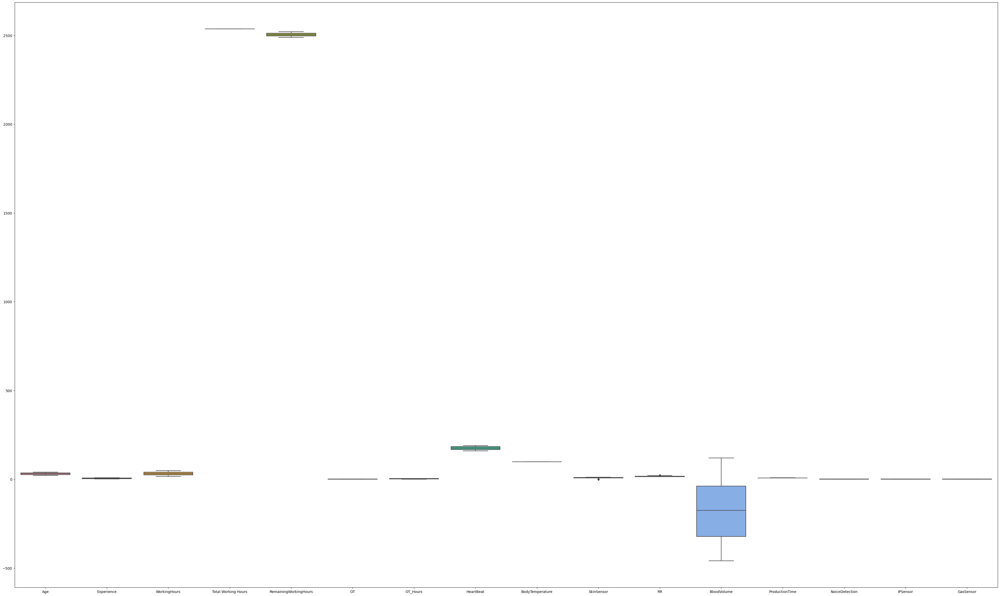

In [17]:
import matplotlib.pyplot as plt
fig=plt.figure(figsize=(50,30))
sns.boxplot(data= df)
plt.show()

## Data Visualization

### 3.1 Count Plots


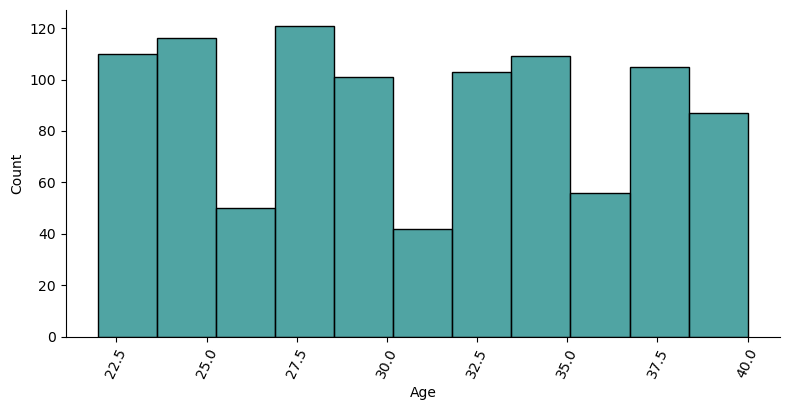

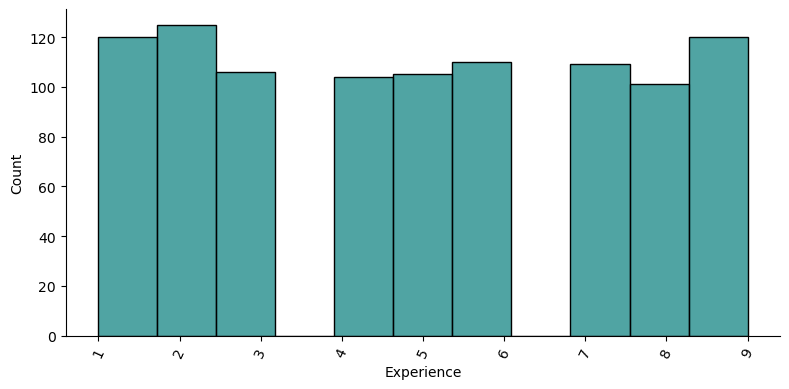

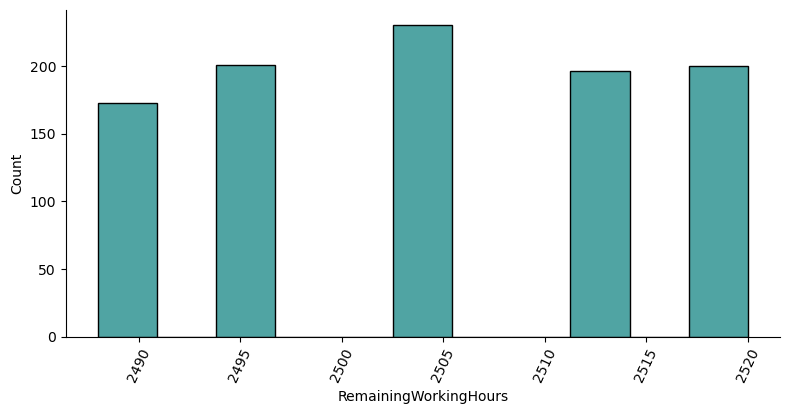

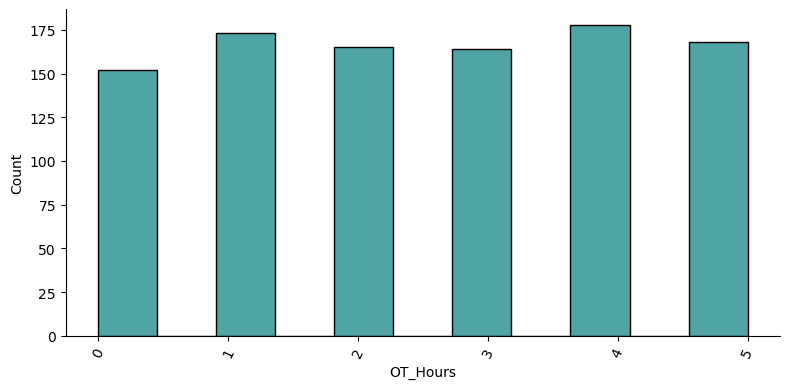

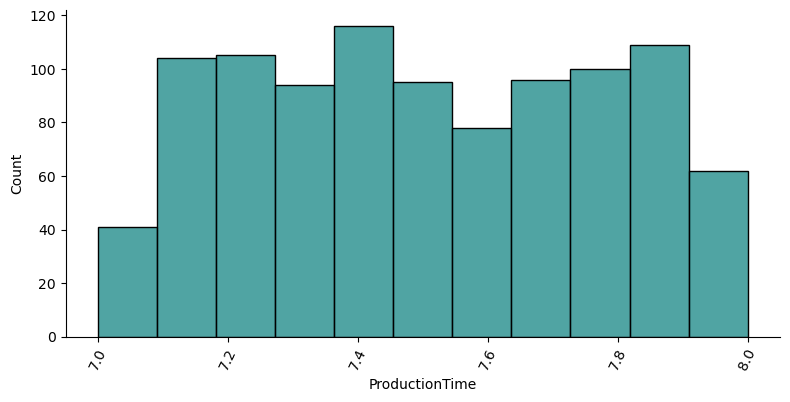

In [18]:
features_continuous = ['Age','Experience','RemainingWorkingHours', 'OT_Hours',"ProductionTime"]
for feature in features_continuous:
  sns.displot(data=df, x=feature, height=4, aspect=2,color='#158685')
  plt.xticks(rotation=65)
  plt.show()

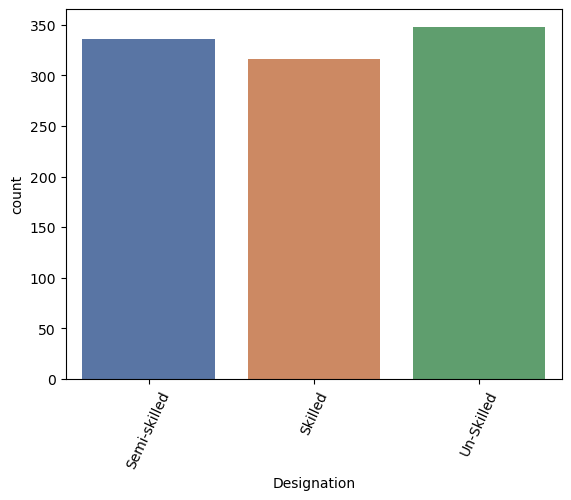

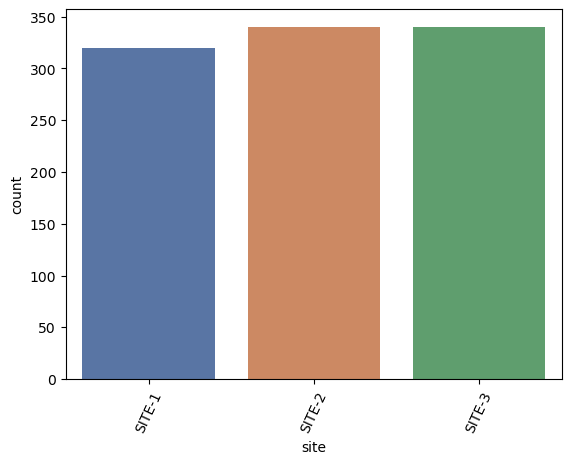

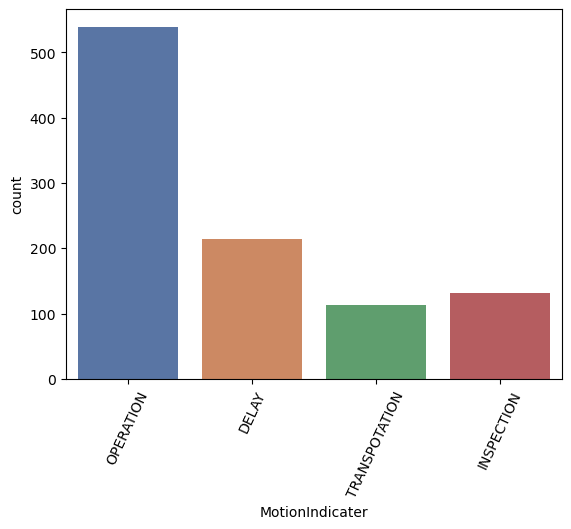

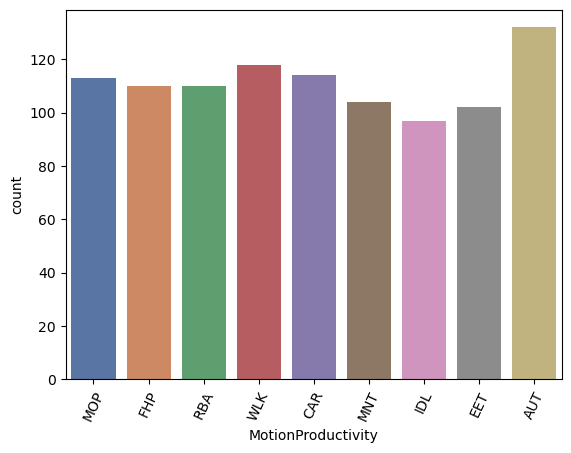

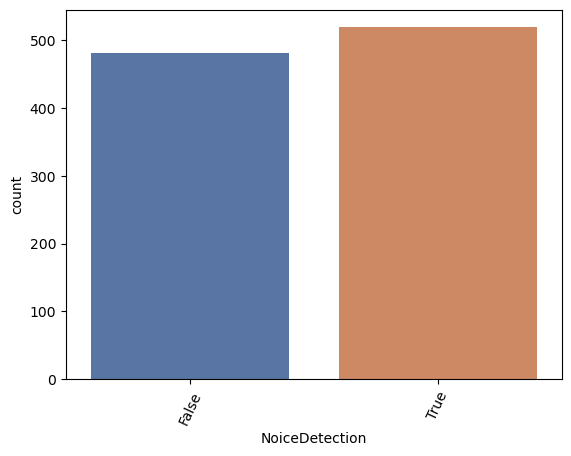

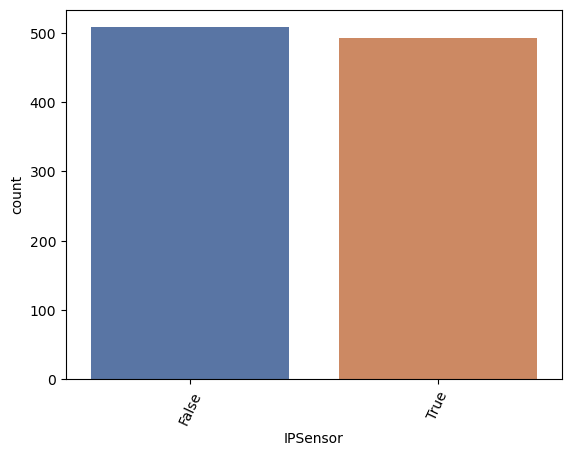

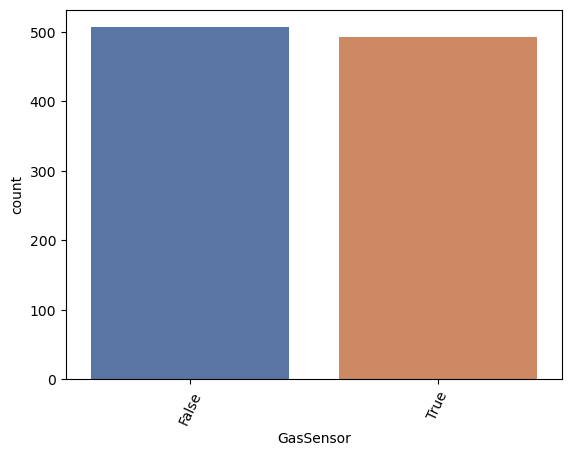

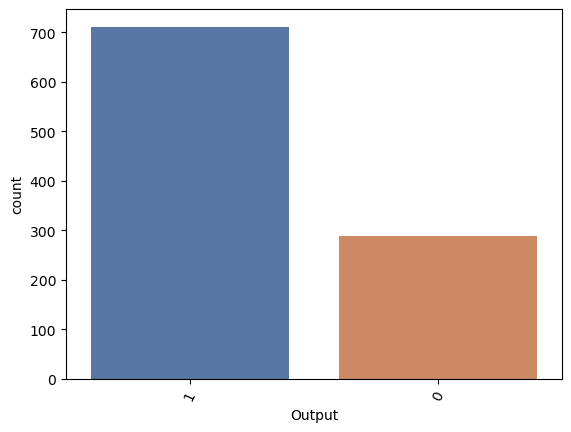

In [19]:
features_category = ['Designation','site', 'MotionIndicater','MotionProductivity','NoiceDetection','IPSensor','GasSensor','Output']
for feature in features_category:
  sns.countplot(data=df, x=feature, palette='deep')
  plt.xticks(rotation=65)
  plt.show()


<function matplotlib.pyplot.show(close=None, block=None)>

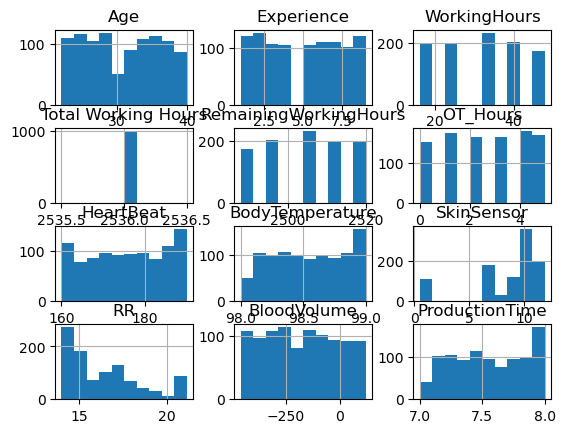

In [20]:
# histogram
df.hist()
plt.show# overall distribution of data

In [21]:
values = df['Nationality'].value_counts()
labels = df['Nationality'].unique().tolist()

fig = px.pie(df, values = values, labels = labels, title = 'Nationality')

fig.show()
print(values)

India                   342
Indonesia               339
United States           267
Malaysia                 33
United Arab Emirates     19
Name: Nationality, dtype: int64


In [22]:
df1= df.drop(["Employee ID","Name","Gender","Attendence","Nationality","OT","site","Location","Qualification","Place","RFIDTag","Time In","Time Out","Total Working Hours","Tool ID","IPSensor","GasSensor"],axis=1)
df1

,Age,Designation,Experience,WorkingHours,RemainingWorkingHours,OT_Hours,HeartBeat,BodyTemperature,SkinSensor,RR,BloodVolume,MotionProductivity,MotionIndicater,ProductionTime,NoiceDetection,Output
0,37,Semi-skilled,9,24,2512,0,169,98.5,9.92,15.5,-224.34,MOP,OPERATION,8.0,False,1
1,38,Skilled,7,32,2504,2,190,98.4,10.49,15.4,5.96,FHP,OPERATION,7.0,False,1
2,28,Skilled,5,16,2520,3,180,98.6,10.81,16.7,-309.93,RBA,OPERATION,7.5,True,1
3,34,Skilled,1,48,2488,3,169,98.5,9.02,15.6,-35.19,WLK,DELAY,7.3,False,1
4,37,Semi-skilled,2,32,2504,2,185,98.5,0.49,15.7,-229.73,CAR,TRANSPOTATION,7.4,True,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,31,Semi-skilled,6,48,2488,1,162,98.0,7.25,14.0,-329.03,AUT,INSPECTION,7.8,False,0
996,34,Un-Skilled,6,48,2488,5,174,98.5,10.51,15.6,-286.20,RBA,OPERATION,7.4,True,1
997,31,Skilled,3,16,2520,5,175,98.5,11.52,15.6,-298.47,MOP,OPERATION,7.2,True,1
998,25,Un-Skilled,6,16,2520,1,187,98.1,10.81,14.5,-131.07,MOP,OPERATION,7.2,True,0


In [23]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Age                    1000 non-null   int64  
 1   Designation            1000 non-null   object 
 2   Experience             1000 non-null   int64  
 3   WorkingHours           1000 non-null   int64  
 4   RemainingWorkingHours  1000 non-null   int64  
 5   OT_Hours               1000 non-null   int64  
 6   HeartBeat              1000 non-null   int64  
 7   BodyTemperature        1000 non-null   float64
 8   SkinSensor             1000 non-null   float64
 9   RR                     1000 non-null   float64
 10  BloodVolume            1000 non-null   float64
 11  MotionProductivity     1000 non-null   object 
 12  MotionIndicater        1000 non-null   object 
 13  ProductionTime         1000 non-null   float64
 14  NoiceDetection         1000 non-null   bool   
 15  Outpu

#### 4. Data Preprocessing

In [24]:
labelencoder = LabelEncoder()

In [25]:
df1["Designation"]= labelencoder.fit_transform(df1["Designation"])
df1["MotionProductivity"]= labelencoder.fit_transform(df1["MotionProductivity"])
df1["MotionIndicater"] = labelencoder.fit_transform(df1["MotionIndicater"])
df1["NoiceDetection"]= labelencoder.fit_transform(df1["NoiceDetection"])
df1

,Age,Designation,Experience,WorkingHours,RemainingWorkingHours,OT_Hours,HeartBeat,BodyTemperature,SkinSensor,RR,BloodVolume,MotionProductivity,MotionIndicater,ProductionTime,NoiceDetection,Output
0,37,0,9,24,2512,0,169,98.5,9.92,15.5,-224.34,6,2,8.0,0,1
1,38,1,7,32,2504,2,190,98.4,10.49,15.4,5.96,3,2,7.0,0,1
2,28,1,5,16,2520,3,180,98.6,10.81,16.7,-309.93,7,2,7.5,1,1
3,34,1,1,48,2488,3,169,98.5,9.02,15.6,-35.19,8,0,7.3,0,1
4,37,0,2,32,2504,2,185,98.5,0.49,15.7,-229.73,1,3,7.4,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,31,0,6,48,2488,1,162,98.0,7.25,14.0,-329.03,0,1,7.8,0,0
996,34,2,6,48,2488,5,174,98.5,10.51,15.6,-286.20,7,2,7.4,1,1
997,31,1,3,16,2520,5,175,98.5,11.52,15.6,-298.47,6,2,7.2,1,1
998,25,2,6,16,2520,1,187,98.1,10.81,14.5,-131.07,6,2,7.2,1,0


#### Pairplot

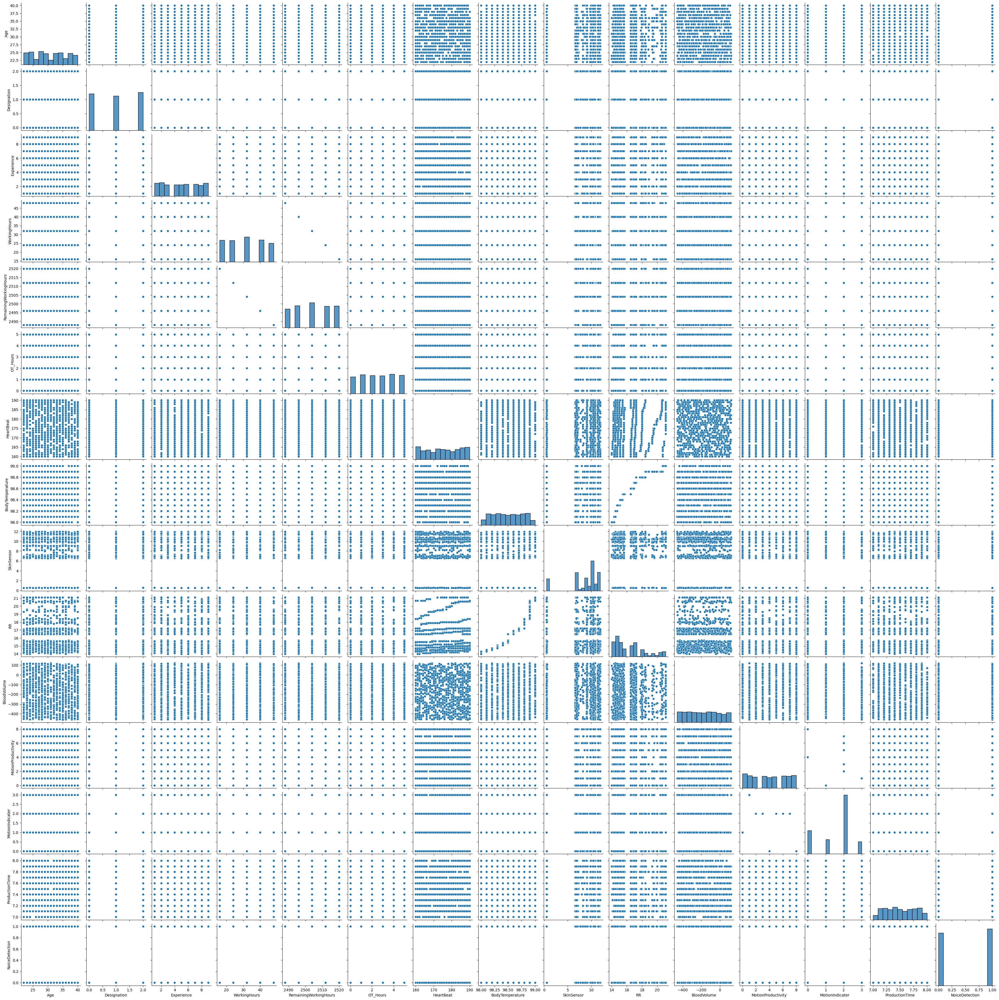

In [26]:
sns.pairplot(df1)

### 3.5 Correlation Coefficent Plot

<AxesSubplot:>

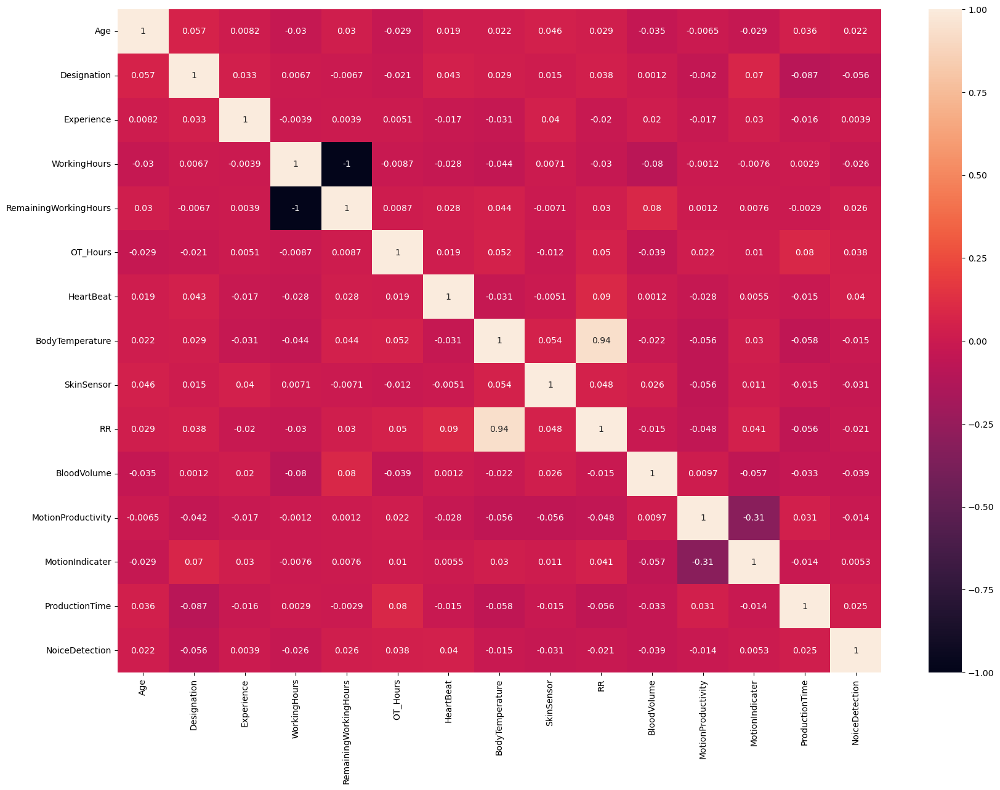

In [27]:
corelation = df1.corr()
plt.figure(figsize=(20,14))
sns.heatmap(corelation, xticklabels=corelation.columns, yticklabels=corelation.columns, annot=True)

#### 4.2 Variance, Skewness and Kurtosis

In [28]:
df1.var() # variance of Numeric Variables

Age                         29.418903
Designation                  0.684541
Experience                   6.951351
WorkingHours               120.863199
RemainingWorkingHours      120.863199
OT_Hours                     2.872664
HeartBeat                   84.867171
BodyTemperature              0.086226
SkinSensor                  10.503840
RR                           3.945682
BloodVolume              27765.768506
MotionProductivity           7.094390
MotionIndicater              0.906202
ProductionTime               0.087850
NoiceDetection               0.249889
dtype: float64

In [29]:
df1.skew() 

Age                      0.045555
Designation             -0.022350
Experience               0.034599
WorkingHours             0.025681
RemainingWorkingHours   -0.025681
OT_Hours                -0.028427
HeartBeat               -0.054385
BodyTemperature         -0.004754
SkinSensor              -1.555505
RR                       0.909149
BloodVolume              0.047250
MotionProductivity       0.009754
MotionIndicater         -0.501549
ProductionTime           0.030299
NoiceDetection          -0.076169
Output                  -0.932354
dtype: float64

In [30]:
df1.kurt()

Age                     -1.219023
Designation             -1.539055
Experience              -1.270912
WorkingHours            -1.215760
RemainingWorkingHours   -1.215760
OT_Hours                -1.265756
HeartBeat               -1.236504
BodyTemperature         -1.195173
SkinSensor               1.471647
RR                      -0.186516
BloodVolume             -1.166738
MotionProductivity      -1.293884
MotionIndicater         -0.823135
ProductionTime          -1.205753
NoiceDetection          -1.998199
Output                  -1.132986
dtype: float64

## 5.Model Building

In [31]:
# separating the data and labels
X = df1.drop(columns = 'Output', axis=1)
Y = df1['Output']

In [32]:
# Normalization function

def norm_func(i):
    x = (i - i.min())/(i.max() - i.min())
    return (x)

# Normalized data frame (considering the numerical part of data)
df1 = norm_func(X)

In [33]:
df1

,Age,Designation,Experience,WorkingHours,RemainingWorkingHours,OT_Hours,HeartBeat,BodyTemperature,SkinSensor,RR,BloodVolume,MotionProductivity,MotionIndicater,ProductionTime,NoiceDetection
0,0.833333,0.0,1.000,0.25,0.75,0.0,0.300000,0.5,0.824301,0.211268,0.406486,0.750,0.666667,1.0,0.0
1,0.888889,0.5,0.750,0.50,0.50,0.4,1.000000,0.4,0.874126,0.197183,0.804200,0.375,0.666667,0.0,0.0
2,0.333333,0.5,0.500,0.00,1.00,0.6,0.666667,0.6,0.902098,0.380282,0.258678,0.875,0.666667,0.5,1.0
3,0.666667,0.5,0.000,1.00,0.00,0.6,0.300000,0.5,0.745629,0.225352,0.733136,1.000,0.000000,0.3,0.0
4,0.833333,0.0,0.125,0.50,0.50,0.4,0.833333,0.5,0.000000,0.239437,0.397178,0.125,1.000000,0.4,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.500000,0.0,0.625,1.00,0.00,0.2,0.066667,0.0,0.590909,0.000000,0.225693,0.000,0.333333,0.8,0.0
996,0.666667,1.0,0.625,1.00,0.00,1.0,0.466667,0.5,0.875874,0.225352,0.299658,0.875,0.666667,0.4,1.0
997,0.500000,0.5,0.250,0.00,1.00,1.0,0.500000,0.5,0.964161,0.225352,0.278469,0.750,0.666667,0.2,1.0
998,0.166667,1.0,0.625,0.00,1.00,0.2,0.900000,0.1,0.902098,0.070423,0.567558,0.750,0.666667,0.2,1.0


In [34]:
X = df1
X
Y

0      1
1      1
2      1
3      1
4      1
      ..
995    0
996    1
997    1
998    0
999    1
Name: Output, Length: 1000, dtype: object

In [52]:
# splitting the data into testing and training data.

from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2)

In [53]:
print(X.shape, X_train.shape, X_test.shape)

(1000, 15) (800, 15) (200, 15)


In [54]:
# Support Vector Machine (SVM-Black Box Technique)   
from sklearn import svm
from sklearn.metrics import accuracy_score
classifier = svm.SVC(kernel='linear')

In [55]:
#training the support vector Machine Classifier
classifier.fit(X_train, Y_train)

SVC(kernel='linear')

In [56]:
# accuracy score on the training data
X_train_prediction = classifier.predict(X_train)
training_data_accuracy = accuracy_score(X_train_prediction, Y_train)
print('Accuracy score of the training data : ', training_data_accuracy)

Accuracy score of the training data :  0.7075


In [57]:
# accuracy score on the test data
X_test_prediction = classifier.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)
print('Accuracy score of the test data : ', test_data_accuracy)

Accuracy score of the test data :  0.725


In [58]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()

In [59]:
# training the LogisticRegression model with Training data
model.fit(X_train, Y_train)

LogisticRegression()

In [60]:
# accuracy on training data
X_train_prediction = model.predict(X_train)
training_data_accuracy = accuracy_score(X_train_prediction, Y_train)

In [61]:
print('Accuracy on Training data : ', training_data_accuracy)

Accuracy on Training data :  0.7075


In [62]:
# accuracy on test data
X_test_prediction = model.predict(X_test)
test_data_accuracy = accuracy_score(X_test_prediction, Y_test)

In [63]:
print('Accuracy on Test data : ', test_data_accuracy)

Accuracy on Test data :  0.725


In [64]:
#Desicion tree Model

#Load libraries
import pandas as pd
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.metrics import accuracy_score,confusion_matrix

# Model building for Decision Tree

dtc = DecisionTreeClassifier(criterion="gini", max_depth=3)

dtc.fit(X_train,Y_train)
Y_train_pred = dtc.predict(X_train)
Y_test_pred = dtc.predict(X_test)

print(f'Train score {accuracy_score(Y_train_pred,Y_train)}') 
print(f'Test score {accuracy_score(Y_test_pred,Y_test)}') 

# confusion matrix for performance metrics
cm = confusion_matrix(Y_test, Y_test_pred)
cm
# or
pd.crosstab(Y_test, Y_test_pred, rownames=['Actual'], colnames=['Predictions'])

# Classification Report
from sklearn.metrics import classification_report
print(classification_report(Y_test, Y_test_pred))

Train score 0.71625
Test score 0.705
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        55
           1       0.72      0.97      0.83       145

    accuracy                           0.70       200
   macro avg       0.36      0.49      0.41       200
weighted avg       0.52      0.70      0.60       200



In [48]:
# Training the model Random forest model
from sklearn.ensemble import RandomForestClassifier

classifier_rfg=RandomForestClassifier(random_state=33,n_estimators=23)
parameters=[{'min_samples_split':[2,3,4,5],'criterion':['gini','entropy'],'min_samples_leaf':[1,2,3]}]

model_gridrf=GridSearchCV(estimator=classifier_rfg, param_grid=parameters, scoring='accuracy',cv=10)
model_gridrf.fit(X_train,Y_train)

model_gridrf.best_params_

# Predicting the model
Y_predict_rf = model_gridrf.predict(X_test)

# Finding accuracy, precision, recall and confusion matrix
print(accuracy_score(Y_test,Y_predict_rf))
print(classification_report(Y_test,Y_predict_rf))

0.665
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        58
           1       0.70      0.94      0.80       142

    accuracy                           0.67       200
   macro avg       0.35      0.47      0.40       200
weighted avg       0.49      0.67      0.57       200



In [49]:
# Saving the trained model

In [65]:
import pickle
file = 'model.pkl'
pickle.dump(classifier, open(file,'wb'))

In [67]:
# loading the saved model
loaded_model = pickle.load(open('model.pkl', 'rb'))

In [69]:
## Building a Predictive System 
input_data = (37,0,9,4,2512,0,169,98.5,9.92,15.5,-224.34,6,2,8.0,0)

# changing the input_data to numpy array
input_data_as_numpy_array = np.asarray(input_data)

# reshape the array as we are predicting for one instance
input_data_reshaped = input_data_as_numpy_array.reshape(1,-1)

prediction = loaded_model.predict(input_data_reshaped)
print(prediction)

if (prediction[0] == 0):
  print('The person is not productive')
else:
  print('The person is productive')

['1']
The person is productive
